# import Data


In [1]:
# Importing the pandas library for data manipulation
import pandas as pd

# Reading the CSV file and storing the data in a DataFrame
data = pd.read_csv('/Users/sadiakhanrupa/Bootcamp Main Phase/Chapter_7 Supervised_ML/Data/housing_iteration_5_classification/housing_iteration_5_classification.csv')

In [2]:
data.head()

,LotArea,LotFrontage,TotalBsmtSF,BedroomAbvGr,Fireplaces,PoolArea,GarageCars,WoodDeckSF,ScreenPorch,Expensive,...,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
0,8450,65.0,856,3,0,0,2,0,0,0,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
1,9600,80.0,1262,3,1,0,2,298,0,0,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
2,11250,68.0,920,3,1,0,2,0,0,0,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
3,9550,60.0,756,3,1,0,3,0,0,0,...,Detchd,Unf,TA,TA,Y,NaN,NaN,NaN,WD,Abnorml
4,14260,84.0,1145,4,1,0,3,192,0,0,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal


### checking columns for ordinal coding

ExterQual: Evaluates the quality of the material on the exterior 
		
       Ex	Excellent
       Gd	Good
       TA	Average/Typical
       Fa	Fair
       Po	Poor
		
ExterCond: Evaluates the present condition of the material on the exterior
		
       Ex	Excellent
       Gd	Good
       TA	Average/Typical
       Fa	Fair
       Po	Poor

BsmtQual: Evaluates the height of the basement

       Ex	Excellent (100+ inches)	
       Gd	Good (90-99 inches)
       TA	Typical (80-89 inches)
       Fa	Fair (70-79 inches)
       Po	Poor (<70 inches
       NA	No Basement
		
BsmtCond: Evaluates the general condition of the basement

       Ex	Excellent
       Gd	Good
       TA	Typical - slight dampness allowed
       Fa	Fair - dampness or some cracking or settling
       Po	Poor - Severe cracking, settling, or wetness
       NA	No Basement
	
BsmtExposure: Refers to walkout or garden level walls

       Gd	Good Exposure
       Av	Average Exposure (split levels or foyers typically score average or above)	
       Mn	Mimimum Exposure
       No	No Exposure
       NA	No Basement
	
BsmtFinType1: Rating of basement finished area

       GLQ	Good Living Quarters
       ALQ	Average Living Quarters
       BLQ	Below Average Living Quarters	
       Rec	Average Rec Room
       LwQ	Low Quality
       Unf	Unfinshed
       NA	No Basement

KitchenQual: Kitchen quality

       Ex	Excellent
       Gd	Good
       TA	Typical/Average
       Fa	Fair
       Po	Poor

FireplaceQu: Fireplace quality

       Ex	Excellent - Exceptional Masonry Fireplace
       Gd	Good - Masonry Fireplace in main level
       TA	Average - Prefabricated Fireplace in main living area or Masonry Fireplace in basement
       Fa	Fair - Prefabricated Fireplace in basement
       Po	Poor - Ben Franklin Stove
       NA	No Fireplace

## data splitting


In [3]:
y = data.pop('Expensive')

In [4]:
X = data.copy()

In [5]:
from sklearn.model_selection import train_test_split


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=42)





## check for missing values


In [6]:
X_train.isna().sum() #LotFrontage, BsmtQual, BsmtCond, BsmtExposure, BsmtFinType1, KitchenQual, FireplaceQu has missing values

LotArea             0
LotFrontage       217
TotalBsmtSF         0
BedroomAbvGr        0
Fireplaces          0
                 ... 
PoolQC           1162
Fence             935
MiscFeature      1122
SaleType            0
SaleCondition       0
Length: 80, dtype: int64

In [7]:
X_test.isna().sum() #LotFrontage,BsmtExposure,FireplaceQu have missing values

LotArea            0
LotFrontage       42
TotalBsmtSF        0
BedroomAbvGr       0
Fireplaces         0
                ... 
PoolQC           291
Fence            244
MiscFeature      284
SaleType           0
SaleCondition      0
Length: 80, dtype: int64

## Building the preprocessor

In [8]:
# Importing the necessary libraries

from sklearn import set_config

# Setting the display configuration for scikit-learn
set_config(display='diagram', transform_output='pandas')


In [9]:
# Separate categorical and numerical features
X_cat = X.select_dtypes(exclude='number').copy()
X_num = X.select_dtypes(include='number').copy()
X_cat

,MSZoning,Condition1,Heating,Street,CentralAir,Foundation,ExterQual,ExterCond,BsmtQual,BsmtCond,...,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
0,RL,Norm,GasA,Pave,Y,PConc,Gd,TA,Gd,TA,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
1,RL,Feedr,GasA,Pave,Y,CBlock,TA,TA,Gd,TA,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
2,RL,Norm,GasA,Pave,Y,PConc,Gd,TA,Gd,TA,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
3,RL,Norm,GasA,Pave,Y,BrkTil,TA,TA,TA,Gd,...,Detchd,Unf,TA,TA,Y,NaN,NaN,NaN,WD,Abnorml
4,RL,Norm,GasA,Pave,Y,PConc,Gd,TA,Gd,TA,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,RL,Norm,GasA,Pave,Y,PConc,TA,TA,Gd,TA,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
1456,RL,Norm,GasA,Pave,Y,CBlock,TA,TA,Gd,TA,...,Attchd,Unf,TA,TA,Y,NaN,MnPrv,NaN,WD,Normal
1457,RL,Norm,GasA,Pave,Y,Stone,Ex,Gd,TA,Gd,...,Attchd,RFn,TA,TA,Y,NaN,GdPrv,Shed,WD,Normal
1458,RL,Norm,GasA,Pave,Y,CBlock,TA,TA,TA,TA,...,Attchd,Unf,TA,TA,Y,NaN,NaN,NaN,WD,Normal


In [10]:
#creating pipekine for numeric columns
from sklearn.impute import SimpleImputer
from sklearn.pipeline import make_pipeline
numeric_pipe = make_pipeline(SimpleImputer(strategy='mean'))

In [12]:
# creating pipeline for categorical columns
ordinal_cols_names = ['ExterQual', 'ExterCond', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'KitchenQual', 'FireplaceQu']
ordinal_cols = X_cat.columns.get_indexer(ordinal_cols_names)
non_ordinal_cols_names = set(X_cat.columns).difference(ordinal_cols_names)
onehot_cols =  X_cat.columns.get_indexer(non_ordinal_cols_names)

onehot_cols


array([18, 37, 40, 26, 41, 38,  5, 42, 14, 27, 20,  0, 22, 33, 36, 21,  2,
       15,  3, 35, 25, 19,  1,  4, 16, 24, 31, 28, 23, 39, 30, 34, 29, 32,
       17])

In [13]:
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder
from sklearn.pipeline import make_pipeline
ordinal_cols_rank = [['N_A', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
                     ['N_A', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
                     ['N_A', 'NA','Po', 'Fa', 'TA', 'Gd', 'Ex'],
                     ['N_A', 'NA','Po', 'Fa', 'TA', 'Gd', 'Ex'],
                     ['N_A', 'NA', 'No', 'Mn', 'Av', 'Gd'],
                     ['N_A', 'NA', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'], 
                     ['N_A', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
                     ['N_A', 'NA','Po', 'Fa', 'TA', 'Gd', 'Ex']]

#define categorical preprocessor
categorical_preprocessor = make_column_transformer(
    (OrdinalEncoder(categories=ordinal_cols_rank), ordinal_cols),
    (OneHotEncoder(drop='first', sparse_output=False, handle_unknown='ignore'), onehot_cols)
)

#create categorical_pipeline
categorical_pipe = make_pipeline(SimpleImputer(strategy='constant', fill_value='N_A'),
                                 categorical_preprocessor)

#create final preprocessor
preprocessor = make_column_transformer(
    (numeric_pipe, X_num.columns),
    (categorical_pipe, X_cat.columns)
)
preprocessor

ColumnTransformer(transformers=[('pipeline-1',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer())]),
                                 Index(['LotArea', 'LotFrontage', 'TotalBsmtSF', 'BedroomAbvGr', 'Fireplaces',
       'PoolArea', 'GarageCars', 'WoodDeckSF', 'ScreenPorch', 'MSSubClass',
       'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea',
       'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', '1stFlrSF...
       'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope',
       'Neighborhood', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle',
       'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'BsmtFinType2',
       'HeatingQC', 'Electrical', 'Functional', 'GarageType', 'GarageFinish',
       'GarageQual', 'GarageCond', 'PavedDrive', 'PoolQC', 'Fence',
       'MiscFeature', 'SaleType', 'SaleCondition'],
      dtype='object'))])

# Decision Tree Classifier

In [14]:
from sklearn.tree import DecisionTreeClassifier
# full pipeline = preprocessor + model
full_pipeline = make_pipeline(
    preprocessor,
    DecisionTreeClassifier()
)


In [15]:
#importing necessary modules
from sklearn.model_selection import GridSearchCV

param_grid = {
    'columntransformer__pipeline-1__simpleimputer__strategy':['mean', 'median'],
    'decisiontreeclassifier__criterion':['gini', 'entropy'],
    'decisiontreeclassifier__max_depth':range(2,14,2),
    'decisiontreeclassifier__min_samples_split':range(2,14,2),
    'decisiontreeclassifier__min_samples_leaf':range(3,12,2),
    'decisiontreeclassifier__max_features':['sqrt', 'log2', 4],
    'decisiontreeclassifier__max_leaf_nodes':range(2,15,2)
    
}

#define GridSearchCV
dt_search = GridSearchCV(full_pipeline,
                         param_grid,
                         cv=5,
                         verbose=1)
dt_search.fit(X_train,y_train)
scores = {'dtree':dt_search.best_score_}
print(scores)


Fitting 5 folds for each of 15120 candidates, totalling 75600 fits


/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:227: UserWarning: Found unknown categories in columns [3, 15] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:227: UserWarning: Found unknown categories in columns [15, 20, 30, 33, 34] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:227: UserWarning: Found unknown categories in columns [3, 9, 20, 26] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:227: UserWarning: Found unknown categories in columns [3, 10, 14, 15, 22] during transform. These unknown categories will be encoded as all zeros
 

{'dtree': 0.9289094310553537}


In [27]:
scores = {}
scores = {'dtree':dt_search.best_score_}
scores

{'dtree': 0.9289094310553537}

### Error Analysis

In [16]:
from sklearn.metrics import accuracy_score
accuracy_score(dt_search.predict(X_test), y_test)

/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:227: UserWarning: Found unknown categories in columns [20, 26] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


0.910958904109589

### confusion metrix

/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:227: UserWarning: Found unknown categories in columns [20, 26] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


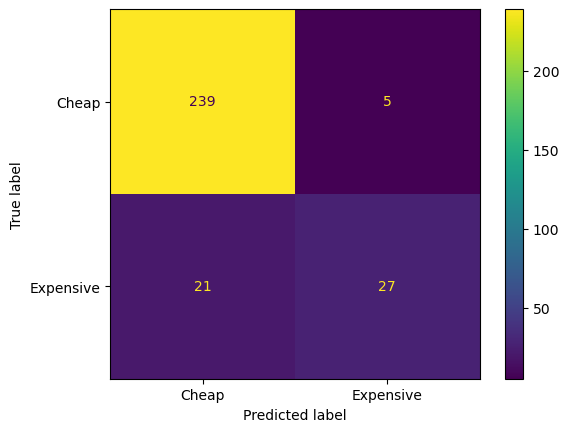

In [17]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(dt_search,
                                      X_test,
                                      y_test,
                                      display_labels=['Cheap', 'Expensive']);

# KNN Classifier


In [38]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler

# full pipeline = preprocessor + model
full_pipeline = make_pipeline(
    preprocessor,
    StandardScaler(),
    KNeighborsClassifier()
)
full_pipeline

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('pipeline-1',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer())]),
                                                  Index(['LotArea', 'LotFrontage', 'TotalBsmtSF', 'BedroomAbvGr', 'Fireplaces',
       'PoolArea', 'GarageCars', 'WoodDeckSF', 'ScreenPorch', 'MSSubClass',
       'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea',
       'BsmtFinSF...
       'Neighborhood', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle',
       'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'BsmtFinType2',
       'HeatingQC', 'Electrical', 'Functional', 'GarageType', 'GarageFinish',
       'GarageQual', 'GarageCond', 'PavedDrive', 'PoolQC', 'Fence',
       'MiscFeature', 'SaleType', 'SaleCondition'],
      dtype='object'))])),
                ('standardscaler', StandardScaler()),
                ('kneighborsclassifier', KNeighborsClassifier())])

### GridSearchCV

In [39]:
#importing necessary modules
from sklearn.model_selection import GridSearchCV

param_grid = {
    'columntransformer__pipeline-1__simpleimputer__strategy':['mean', 'median'],
    'kneighborsclassifier__n_neighbors':range(5,20),
    'kneighborsclassifier__weights':['uniform', 'distance'],
    'kneighborsclassifier__p':range(1,3),
    'kneighborsclassifier__algorithm':['auto', 'ball_tree', 'kd_tree', 'brute']    
}

#define GridSearchCV
knn_search = GridSearchCV(full_pipeline,
                         param_grid,
                         cv=5,
                         verbose=1)
knn_search.fit(X_train,y_train)
scores = {'knn':knn_search.best_score_}
print(scores)


Fitting 5 folds for each of 480 candidates, totalling 2400 fits


/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:227: UserWarning: Found unknown categories in columns [3, 15] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:824: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 813, in _score
    scores = scorer(estimator, X_test, y_test)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_scorer.py", line 527, in __call__
    return estimator.score(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-package

{'knn': 0.9289387770074464}


/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:227: UserWarning: Found unknown categories in columns [2, 3, 16, 20] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/model_selection/_search.py:976: UserWarning: One or more of the test scores are non-finite: [       nan 0.92722204        nan 0.91267011        nan 0.92637467
        nan 0.91352848        nan 0.92637101        nan 0.91780932
        nan 0.92893878        nan 0.91438318        nan 0.92636734
        nan 0.91523789        nan 0.9229412         nan 0.91781299
        nan 0.92465427        nan 0.91780199        nan 0.92636367
        nan 0.91695096        nan 0.92551264        nan 0.91609625
        nan 0.92550163        nan 0.91524522        nan 0.92807674
        nan 0.91866769        nan 0.9280694         nan 0.91695096
        nan 0.92892777        nan 0.91866403       

In [40]:
knn_search.best_params_

{'columntransformer__pipeline-1__simpleimputer__strategy': 'mean',
 'kneighborsclassifier__algorithm': 'auto',
 'kneighborsclassifier__n_neighbors': 8,
 'kneighborsclassifier__p': 1,
 'kneighborsclassifier__weights': 'distance'}

In [41]:
scores = {'knn':knn_search.best_score_,
          'dtree':dt_search.best_score_}
scores

{'knn': 0.9289387770074464, 'dtree': 0.9289094310553537}

### Error Analysis

In [42]:
from sklearn.metrics import accuracy_score
accuracy_score(knn_search.predict(X_test), y_test)

/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:227: UserWarning: Found unknown categories in columns [20, 26] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


0.9486301369863014

### ConfusionMatrix

/Users/sadiakhanrupa/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:227: UserWarning: Found unknown categories in columns [20, 26] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


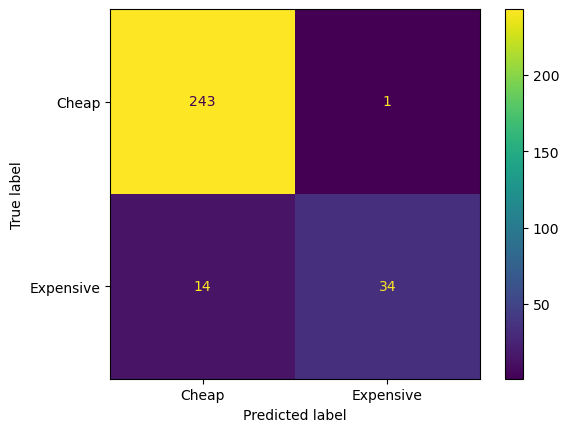

In [43]:
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(knn_search,
                                      X_test,
                                      y_test,
                                      display_labels=['Cheap', 'Expensive']);